### Notebook sur Kaggle

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/bbox-lib-ds/LICENSE.md
/kaggle/input/bbox-lib-ds/.gitignore
/kaggle/input/bbox-lib-ds/README.md
/kaggle/input/bbox-lib-ds/requirements.txt
/kaggle/input/bbox-lib-ds/setup.py
/kaggle/input/bbox-lib-ds/bbox/coco.py
/kaggle/input/bbox-lib-ds/bbox/version.py
/kaggle/input/bbox-lib-ds/bbox/utils.py
/kaggle/input/bbox-lib-ds/bbox/__init__.py
/kaggle/input/bbox-lib-ds/.github/workflows/publish-to-test-pypi.yml
/kaggle/input/yolov5-lib-ds/CONTRIBUTING.md
/kaggle/input/yolov5-lib-ds/train.py
/kaggle/input/yolov5-lib-ds/Dockerfile
/kaggle/input/yolov5-lib-ds/.pre-commit-config.yaml
/kaggle/input/yolov5-lib-ds/setup.cfg
/kaggle/input/yolov5-lib-ds/LICENSE
/kaggle/input/yolov5-lib-ds/tutorial.ipynb
/kaggle/input/yolov5-lib-ds/hubconf.py
/kaggle/input/yolov5-lib-ds/.gitignore
/kaggle/input/yolov5-lib-ds/README.md
/kaggle/input/yolov5-lib-ds/export.py
/kaggle/input/yolov5-lib-ds/.dockerignore
/kaggle/input/yolov5-lib-ds/requirements.txt
/kaggle/input/yolov5-lib-ds/val.py
/kaggle/input/

# **Image Augmentation with Albumentation on Kaggle's TensorFlow_Great_Barrier_Reef Dataset**

**Objectif du concours : identifier avec précision les étoiles de mer (COTS - coral-eating Crown-Of-Thorns Starfish) en temps réel en construisant un modèle de détection d'objets entraîné sur des vidéos sous-marines de récifs coralliens. Nous pourrons ainsi aider les chercheurs et les scientifiques à contrôler les épidémies d'étoiles de mer, qui constituent une menace pour la Grande Barrière de Corail.

Une étoile de mer peut avoir des effets dévastateurs sur l'ensemble d'un récif corallien et, selon l'événement, l'étoile de mer vorace peut anéantir la quasi-totalité des coraux vivants.**

# **Data Structuring and knowing the data**

L'ensemble de données `train.csv` contient 5 colonnes qui permettent d'identifier la position dans la vidéo et la séquence des images .jpg dans le dossier `train_images`.

En outre, il comporte une colonne `annotations`, qui peut être vide (`[]`) ou contenir une ou plusieurs coordonnées pour l'emplacement (ou une boîte de délimitation) de l'étoile de mer.



![](https://imgur.com/a/Dkvn8GB)

L'ensemble de données `train.csv` contient 5 colonnes qui permettent d'identifier la position dans la vidéo et la séquence des images .jpg dans le dossier `train_images`.

En outre, il comporte une colonne `annotations`, qui peut être vide (`[]`) ou contenir une ou plusieurs coordonnées pour l'emplacement (ou une boîte de délimitation) de l'étoile de mer.

Le numéro d'identification de la vidéo peut donc être compris entre 0, 1 et 2, et les images d'entraînement sont également séparées en conséquence, c'est-à-dire que j'ai 3 dossiers nommés video_0, video_1 et video_2.


**video_id** - Numéro d'identification de la vidéo dont l'image fait partie. Les numéros d'identification des vidéos ne sont pas ordonnés de manière significative.

**video_frame** - Numéro d'image de l'image dans la vidéo. Il faut s'attendre à des lacunes occasionnelles dans le numéro d'image à partir du moment où le plongeur est remonté à la surface.

**sequence** - ID d'un sous-ensemble sans lacunes d'une vidéo donnée. Les identifiants de séquence ne sont pas ordonnés de manière significative.

**sequence_frame** - Numéro de l'image dans une séquence donnée.

**Image_id** - Code d'identification de l'image, au format « {video_id}-{video_frame}

**annotations** - Boîtes englobantes de toutes les détections d'étoiles de mer dans un format de chaîne qui peut être évalué directement avec Python. N'utilise pas le même format que les prédictions que vous soumettrez. Non disponible dans test.csv. Une boîte englobante est décrite par la coordonnée du pixel (x_min, y_min) de son coin supérieur gauche dans l'image, ainsi que par sa largeur et sa hauteur en pixels.

**example_sample_submission.csv** - Un fichier de soumission d'échantillon dans le bon format. L'API fournira l'exemple réel de soumission ; celui-ci n'est fourni que pour illustrer la manière de formater correctement les prédictions. Le format de soumission est décrit plus en détail sur la page d'évaluation.

**example_test.npy** - Exemple de données qui seront servies par l'API d'exemple.


---


L'augmentation des données est une technique couramment utilisée pour accroître à la fois la taille et la diversité des ensembles d'entraînement étiquetés en exploitant les transformations d'entrée qui préservent les étiquettes de sortie correspondantes. En vision artificielle, les augmentations d'images sont devenues une technique de régularisation implicite courante pour lutter contre le surajustement dans les modèles d'apprentissage profond et sont omniprésentes pour améliorer les performances.

In [2]:
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
sns.set_style('darkgrid')

from PIL import Image, ImageDraw
import tensorflow as tf

import os
import ast  ## Change str -> list.


import albumentations as A

import warnings
warnings.filterwarnings("ignore")

import os
import cv2 
import pandas as pd
import numpy as np

import ast
import sys

from tqdm.notebook import tqdm
tqdm.pandas()

from PIL import Image
from IPython.display import display

2024-05-30 11:38:07.252681: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-30 11:38:07.252855: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-30 11:38:07.430486: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [3]:
# Root Dir in Kaggle
ROOT_DIR  = '/kaggle/input/tensorflow-great-barrier-reef/'

df = pd.read_csv(ROOT_DIR + "train.csv")
df.head()

,video_id,sequence,video_frame,sequence_frame,image_id,annotations
0,0,40258,0,0,0-0,[]
1,0,40258,1,1,0-1,[]
2,0,40258,2,2,0-2,[]
3,0,40258,3,3,0-3,[]
4,0,40258,4,4,0-4,[]


In [4]:
df_train = pd.read_csv(ROOT_DIR + "train.csv")

# Create a new column named path_of_image in the above dataframe
df_train['path_of_img'] = os.path.join(ROOT_DIR+ 'train_images')+'/video_'+ df_train.video_id.astype(str)+'/'+ df_train.video_frame.astype(str) + '.jpg'

df_train.head(20)

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,path_of_img
0,0,40258,0,0,0-0,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
1,0,40258,1,1,0-1,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
2,0,40258,2,2,0-2,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
3,0,40258,3,3,0-3,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
4,0,40258,4,4,0-4,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
5,0,40258,5,5,0-5,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
6,0,40258,6,6,0-6,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
7,0,40258,7,7,0-7,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
8,0,40258,8,8,0-8,[],/kaggle/input/tensorflow-great-barrier-reef/tr...
9,0,40258,9,9,0-9,[],/kaggle/input/tensorflow-great-barrier-reef/tr...


In [5]:
df_train['path_of_img'][0]

'/kaggle/input/tensorflow-great-barrier-reef/train_images/video_0/0.jpg'

Comptons le nombre d'images de chacune des trois vidéos.

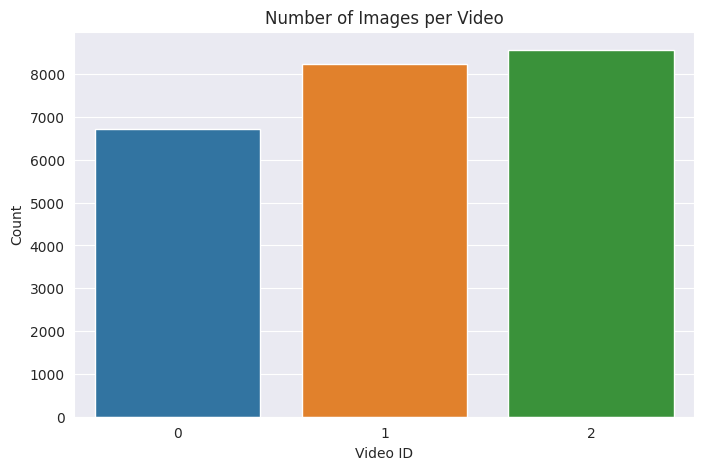

In [6]:
# Filtrer les données pour les vidéos 0, 1 et 2
filtered_df = df[df['video_id'].isin([0, 1, 2])]

# Afficher le compte des images par vidéo
plt.figure(figsize=(8, 5))
sns.countplot(data=filtered_df, x='video_id')
plt.title('Number of Images per Video')
plt.xlabel('Video ID')
plt.ylabel('Count')
plt.show()

Pour vérifier si les données sont équilibrées ou déséquilibrées, calculez le nombre d'images avec cadre et le nombre d'images sans cadre.

In [7]:
with_annotation = len(df_train[df_train['annotations'] != '[]'])
without_annotation = len(df_train[df_train['annotations'] == '[]'])

labels = ['Without Bounding Box', 'With Bounding Box']

fig = go.Figure([go.Bar(x=labels, 
                        y=[without_annotation, with_annotation], width=0.6)])

fig.update_layout(autosize=False, width=700, height=400, margin=dict(l=60, r=60, b=50, t=50, pad=4))
fig.show()

### Maintenant, pour sélectionner une image à laquelle appliquer toutes les augmentations du paquet albumentations, je dois trouver des images qui ont beaucoup de « boîtes de délimitation » dans la colonne des annotations. En fait, ces images contiennent beaucoup d'étoiles de mer.

Nous allons donc commencer par créer un df pour toutes les images comportant plus de 5 annotations.

Pour cela, il faut d'abord déterminer le nombre de boîtes de délimitation dans chaque colonne d'annotations.

Je peux simplement compter le nombre de crochets fermés - '}' dans la colonne d'annotation.

Par exemple, en regardant train.csv - Pour video_frame no 36, j'ai ce qui suit dans la colonne d'annotations

`[{'x' : 520, 'y' : 148, 'width' : 80, 'height' : 63}, {'x' : 598, 'y' : 206, 'width' : 61, 'height' : 34}]`

Ce qui signifie qu'il a 2 boîtes de délimitation.

In [8]:
df_train['num_of_bboxes'] = df_train['annotations'].apply(lambda x: x.count('}'))

df_train.head(40)

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,path_of_img,num_of_bboxes
0,0,40258,0,0,0-0,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
1,0,40258,1,1,0-1,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
2,0,40258,2,2,0-2,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
3,0,40258,3,3,0-3,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
4,0,40258,4,4,0-4,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
5,0,40258,5,5,0-5,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
6,0,40258,6,6,0-6,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
7,0,40258,7,7,0-7,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
8,0,40258,8,8,0-8,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
9,0,40258,9,9,0-9,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0


In [9]:
df_train['num_of_bboxes'] = df_train['annotations'].apply(lambda x: x.count('}'))

df_train.head()
df_train['annotations'][36]

"[{'x': 520, 'y': 148, 'width': 80, 'height': 63}, {'x': 598, 'y': 206, 'width': 61, 'height': 34}]"

In [10]:
bbox_count_fig = px.bar(df_train['num_of_bboxes'].value_counts().drop(0), title='Plot of Num of Bboxes')
bbox_count_fig.update_layout(autosize=False, width = 700, height=500, margin=dict(l=45, b=45, t=45, pad=3))
bbox_count_fig.show()

Un grand nombre d'images n'ont qu'une seule boîte de délimitation. Très peu d'entre elles ont plus de 5 boîtes englobantes.

Ainsi, pour construire mon df basé sur le nombre de boîtes englobantes, il faut d'abord changer le type de données 'annotations' de string en list à l'aide de ast.

In [11]:
df_train['annotations'] = df_train['annotations'].apply(ast.literal_eval)

df_train.head()

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,path_of_img,num_of_bboxes
0,0,40258,0,0,0-0,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
1,0,40258,1,1,0-1,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
2,0,40258,2,2,0-2,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
3,0,40258,3,3,0-3,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0
4,0,40258,4,4,0-4,[],/kaggle/input/tensorflow-great-barrier-reef/tr...,0


Création d'un nouveau DataFrame contenant des images avec 4 Bounding Boxes et utilisation de la ligne 'video_id' pour voir l'image avec les Bounding Boxes.

In [12]:
df_train_bbox_4 = df_train[df_train['annotations'].astype(str) != "[]"]
df_train_bbox_4 = df_train_bbox_4[df_train_bbox_4['num_of_bboxes'] == 4]
df_train_bbox_4.head(20)

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,path_of_img,num_of_bboxes
2635,0,8399,4558,820,0-4558,"[{'x': 186, 'y': 67, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2636,0,8399,4559,821,0-4559,"[{'x': 185, 'y': 71, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2637,0,8399,4560,822,0-4560,"[{'x': 185, 'y': 74, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2638,0,8399,4561,823,0-4561,"[{'x': 184, 'y': 78, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2639,0,8399,4562,824,0-4562,"[{'x': 182, 'y': 80, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2640,0,8399,4563,825,0-4563,"[{'x': 179, 'y': 81, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2641,0,8399,4564,826,0-4564,"[{'x': 177, 'y': 83, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2642,0,8399,4565,827,0-4565,"[{'x': 175, 'y': 85, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2643,0,8399,4566,828,0-4566,"[{'x': 173, 'y': 86, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4
2644,0,8399,4567,829,0-4567,"[{'x': 170, 'y': 88, 'width': 50, 'height': 43...",/kaggle/input/tensorflow-great-barrier-reef/tr...,4


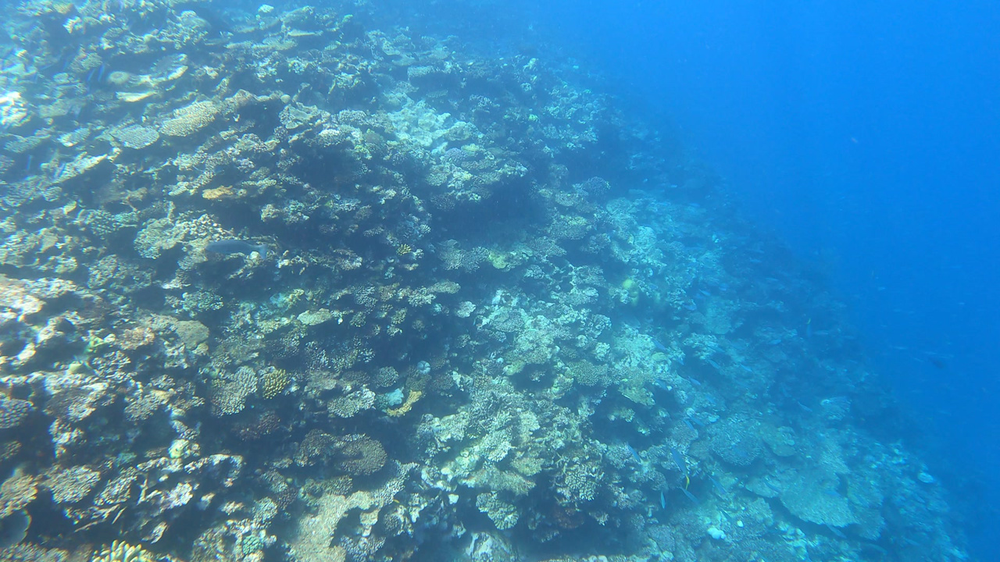

In [13]:
img_selected = df_train_bbox_4['path_of_img'][2635]
img_selected_display = Image.open(img_selected)
display(img_selected_display)

### dessiner les boîtes de délimitation avec ImageDraw.Draw

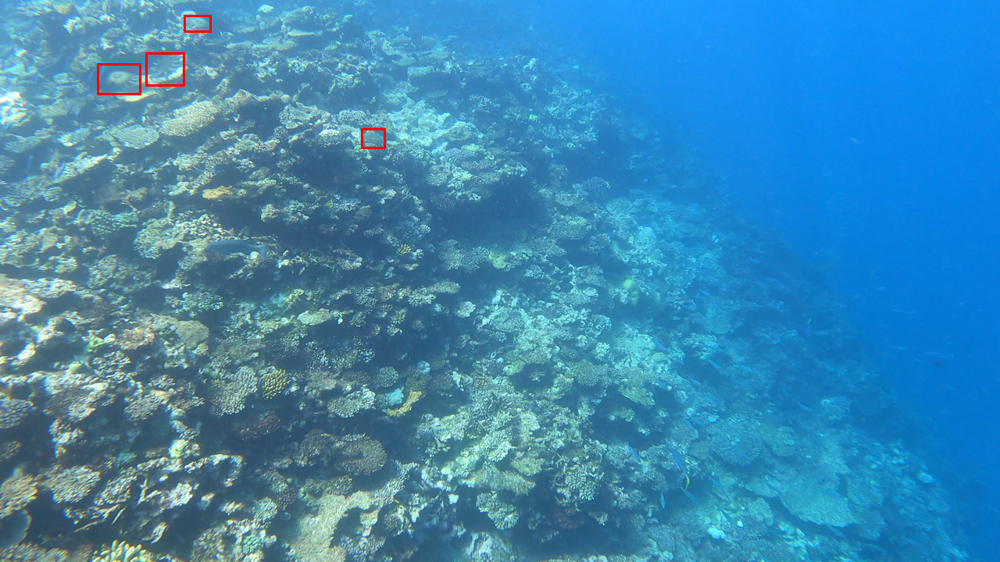

In [14]:
def get_img_with_rectangle(img, id):    
    for box in df_train['annotations'][id]:
        # Four points to define the bounding box. Sequence of either 
        # [(x0, y0), (x1, y1)] or [x0, y0, x1, y1]. 
        # The second point is just outside the drawn rectangle.
        shape = [box['x'], box['y'], box['x']+box['width'], box['y']+box['height']]
        ImageDraw.Draw(img).rectangle(shape, outline ="red", width=3)
    return img

random_img_path  = df_train['path_of_img'][2635]
random_img = Image.open(random_img_path)
get_img_with_rectangle(random_img, id=2635)

In [15]:
def get_augmented_img(img, augmentation_method):
    """
        img: a numpy array of the image
        augmentation: Any of the Official Augmentation methods
        https://albumentations.ai/docs/getting_started/transforms_and_targets/
        
        returns: The augmented image as a numpy array. 
        So to get the image, we will need to use the Image.fromarray() method.
    """
    transform = A.Compose([augmentation_method])
    augmented_img = transform(image=img)['image']
    return(augmented_img)

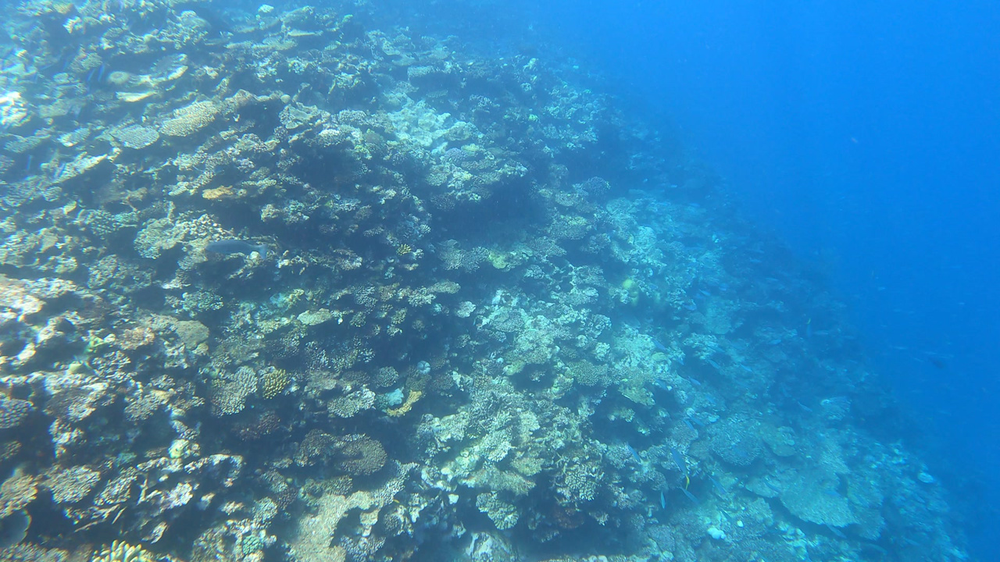

In [16]:
img_selected = df_train_bbox_4['path_of_img'][2635]
img_selected_display = Image.open(img_selected)
display(img_selected_display)

Note pour la plupart des méthodes - Le paramètre « p » est la probabilité d'appliquer la transformation. Valeur par défaut : 0,5.



## Blur

Pourquoi le Blur est-il parfois nécessaire ? 

Le Blur peut être appliqué en tant que technique de prétraitement ou d'augmentation de l'image. Si toutes les images en production sont susceptibles d'être floues, toutes les images d'entraînement, de validation et de test doivent être floutées lors du prétraitement. Plus couramment, cependant, seules certaines images peuvent être floues.

Prenons l'exemple suivant :

* Une caméra est immobile, mais les objets qu'elle détecte sont souvent en mouvement ; par exemple, une caméra surveille la circulation.
* Une caméra est en mouvement, mais les objets qu'elle détecte sont immobiles ; par exemple, un utilisateur utilise une application mobile pour scanner la couverture d'un livre.
* Une caméra et les objets qu'elle détecte sont en mouvement ; par exemple, un drone survole un champ de culture venteux pour le détecter.

Dans chacun de ces exemples, le Blur est une étape d'augmentation utile. En d'autres termes, certaines de nos images sont modifiées de manière aléatoire afin de simuler différentes quantités de Blur.

Maintenant, pour 

albumentations.augmentations.transforms.Blur : Blur l'image d'entrée en utilisant un noyau de taille aléatoire.

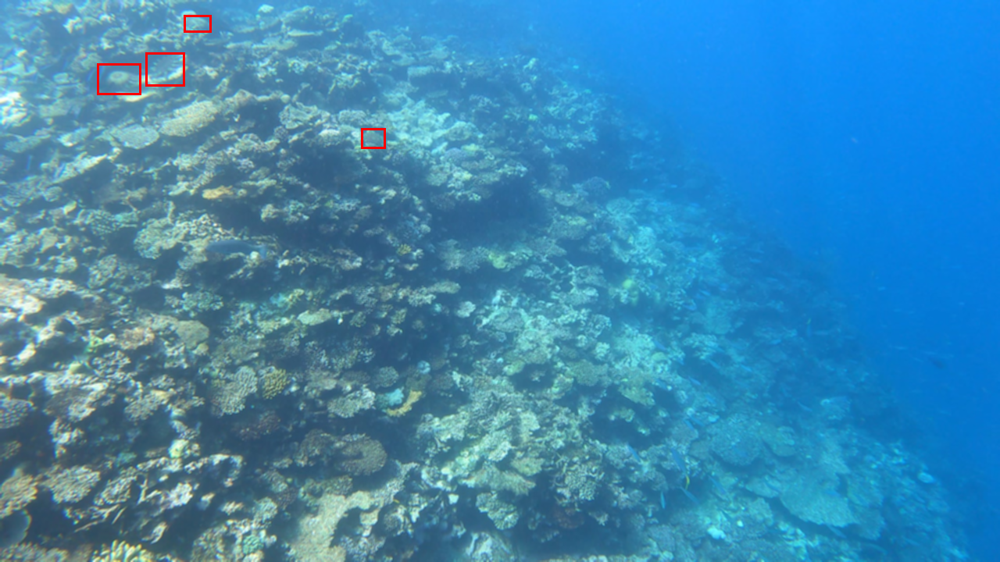

In [17]:
AUGMENTATION = A.Blur(p = 1.0)
# p is probability of applying the transform. Default: 0.5.

np_img = np.array(img_selected_display)

def aug_blur(img):
  img_aug = get_augmented_img(img, AUGMENTATION)    
  img_aug = Image.fromarray(img_aug)
  # fromarray creates an image memory from an object exporting the array interface
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
aug_blur(np_img)  

## Application de MedianBlur

Traditionnellement, la méthode du flou médian s'est avérée la plus efficace pour supprimer les bruits de type sel et poivre. Ce type de bruit est exactement ce à quoi il ressemble : imaginez que vous preniez une photo, que vous la posiez sur la table de votre salle à manger et que vous la saupoudriez de sel et de poivre. En utilisant la méthode du flou médian, vous pouvez supprimer le sel et le poivre de votre image.

Là encore, les méthodes telles que la méthode de la moyenne et la méthode gaussienne calculent des moyennes ou des moyennes pondérées pour le voisinage - l'intensité moyenne du pixel peut être présente ou non dans le voisinage. Mais par définition, le pixel médian doit exister dans notre voisinage. En remplaçant notre pixel central par une médiane plutôt que par une moyenne, nous pouvons réduire considérablement le bruit.

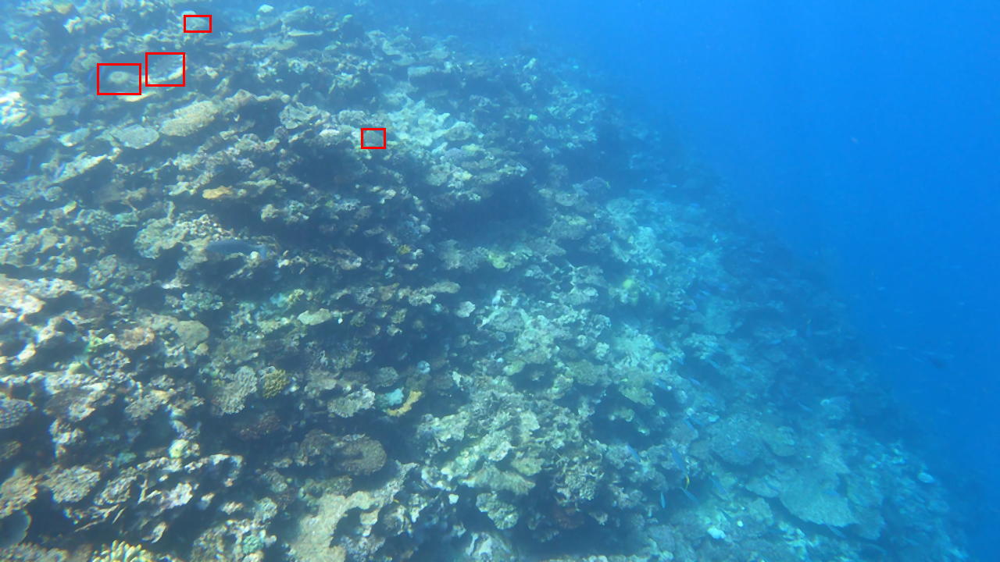

In [18]:
AUGMENTATION = A.MedianBlur(p= 1.0)

def aug_medianblur(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)
aug_medianblur(np_img)
  

### GaussianBlur

Le Blur gaussien utilise la moyenne pondérée, où les pixels du voisinage qui sont plus proches du pixel central contribuent davantage au « poids » de la moyenne.

Comme son nom l'indique, le lissage gaussien est utilisé pour supprimer le bruit qui suit approximativement une distribution gaussienne.

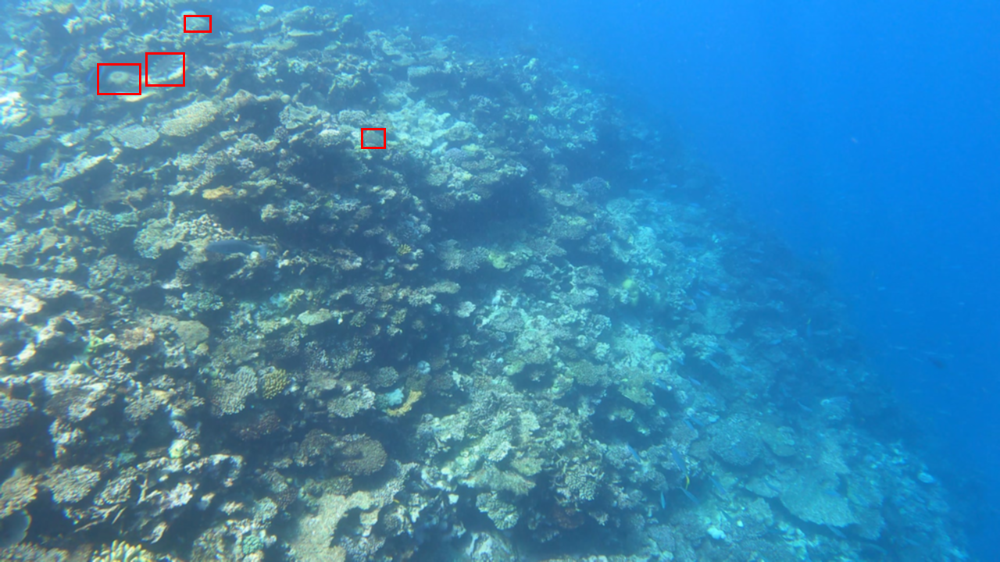

In [19]:
AUGMENTATION = A.GaussianBlur(p= 1.0)

def aug_medianblur(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_medianblur(np_img)
  

## Downscale

Diminue la qualité de l'image en réduisant l'échelle et en la remontant.

scale_min : float et est la limite inférieure de l'échelle de l'image. Doit être < 1.

scale_max : float et est la limite supérieure de l'échelle de l'image. Doit être < 1. scale_max : float et est la limite supérieure de l'échelle de l'image.

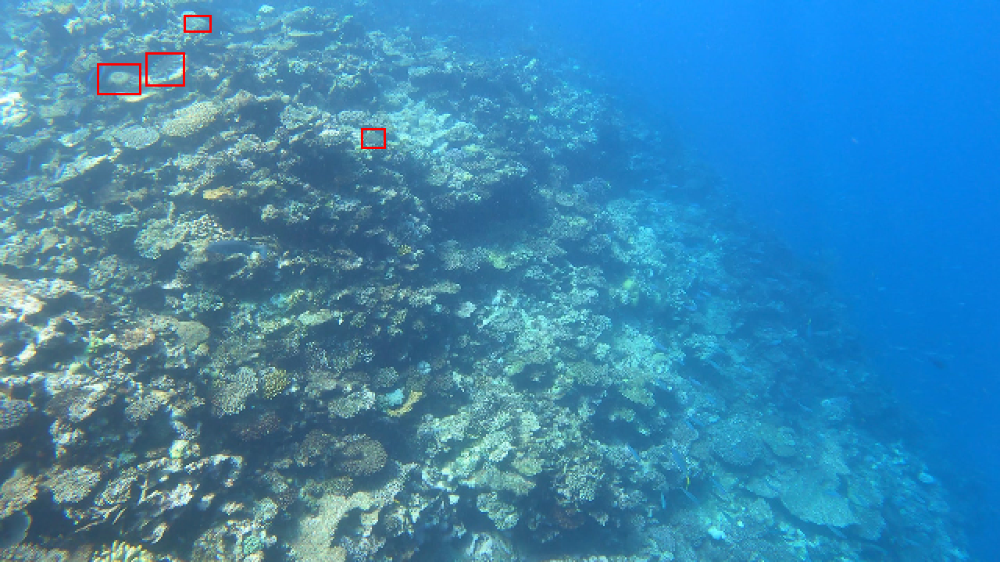

In [20]:
AUGMENTATION = A.Downscale(scale_min=0.5, scale_max=0.5, p=1.0)

def aug_downscale(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_downscale(np_img)


## ImageCompression

Diminue la compression Jpeg, WebP d'une image.

quality_lower : float. limite inférieure de la qualité de l'image. Doit être compris entre [0, 100] pour jpeg et [1, 100] pour webp.

quality_upper : float. limite supérieure de la qualité de l'image. Doit se situer dans la plage [0, 100] pour jpeg et [1, 100] pour webp.

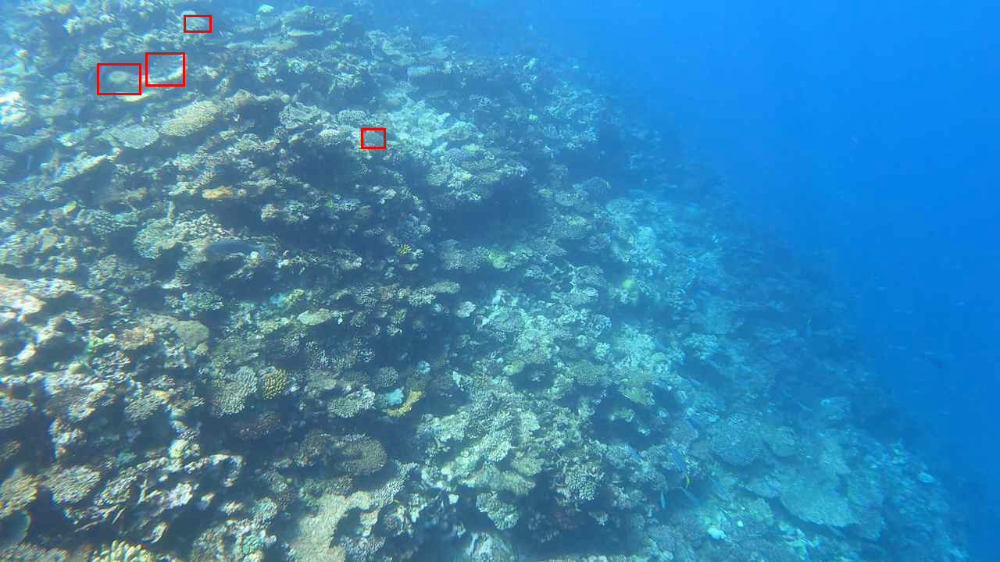

In [21]:
AUGMENTATION = A.ImageCompression(quality_lower=20, quality_upper=40, p = 1.0)

def aug_imgcompression(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_imgcompression(np_img)


# Augmentation de la clarté

### Sharpen

Permet de Sharpen l'image d'entrée et de superposer le résultat à l'image d'origine.

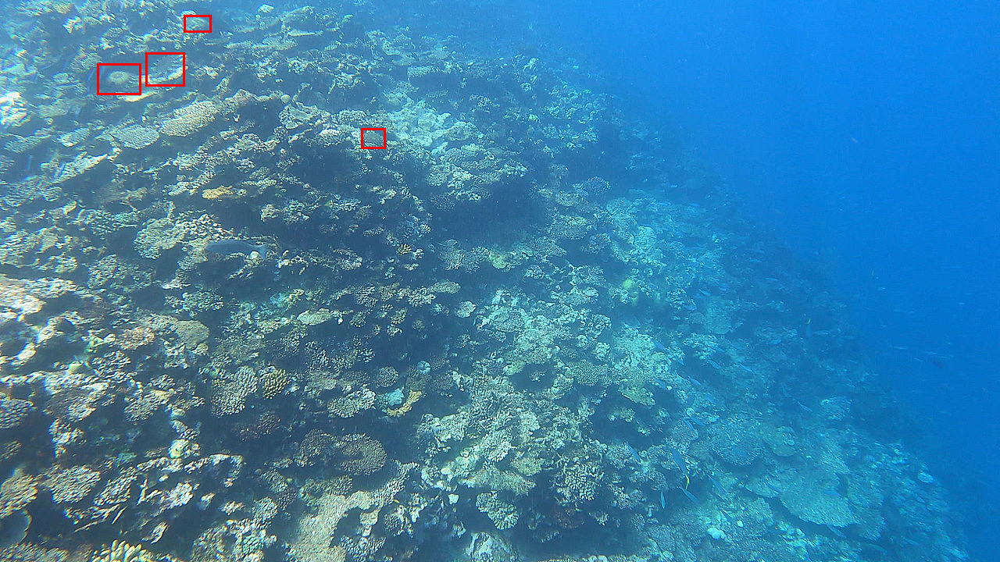

In [22]:
AUGMENTATION = A.Sharpen(p = 1.0)

def aug_shapren(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_shapren(np_img)


### CLAHE

Appliquer l'égalisation adaptative d'histogramme à contraste limité à l'image d'entrée.

**L'égalisation d'histogramme** est une autre technique de traitement d'image qui permet d'augmenter le contraste global d'une image en utilisant l'histogramme d'intensité de l'image. L'image égalisée a une fonction de distribution cumulative linéaire. Cette méthode ne nécessite aucun paramètre, mais elle donne parfois une image peu naturelle.

Une alternative est l'égalisation par histogramme adaptatif (AHE)** qui améliore le contraste local d'une image en calculant plusieurs histogrammes correspondant à différentes sections de l'image (contrairement à l'égalisation par histogramme ordinaire qui utilise un seul histogramme pour ajuster le contraste global), 

Cependant, l'AHE a tendance à amplifier excessivement le bruit dans les régions relativement homogènes d'une image.

C'est alors qu'est apparu CLAHE. L'égalisation adaptative d'histogramme à contraste limité (CLAHE) a été développée pour empêcher la suramplification du bruit résultant de l'AHE. En résumé, elle limite l'amélioration du contraste de l'AHE en coupant l'histogramme à une valeur prédéfinie avant de calculer la fonction de distribution cumulative.

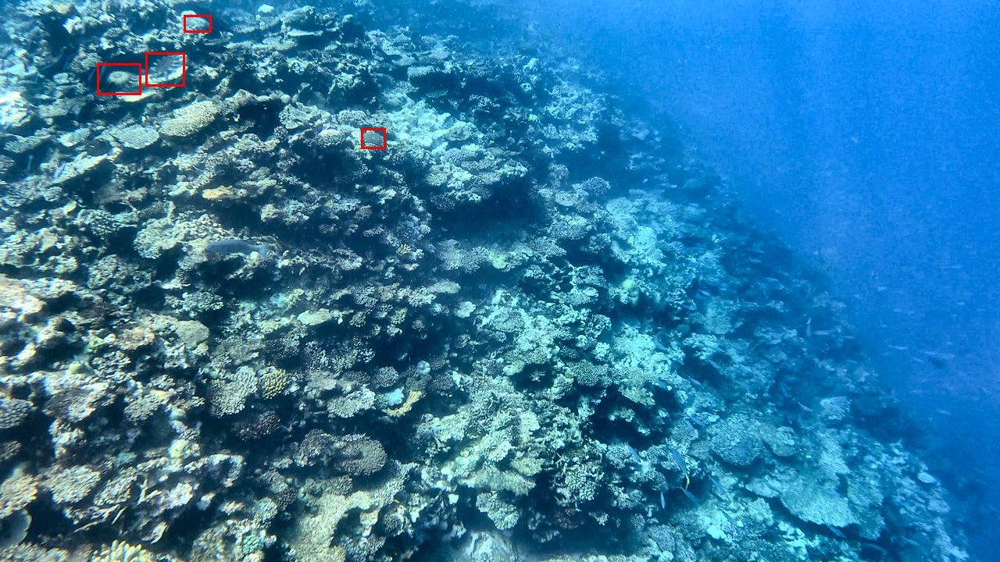

In [23]:
AUGMENTATION = A.CLAHE(p = 1.0)

def aug_clahe(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
 aug_clahe(np_img)

### Emboss

Emboss l'image d'entrée et superpose le résultat à l'image d'origine.

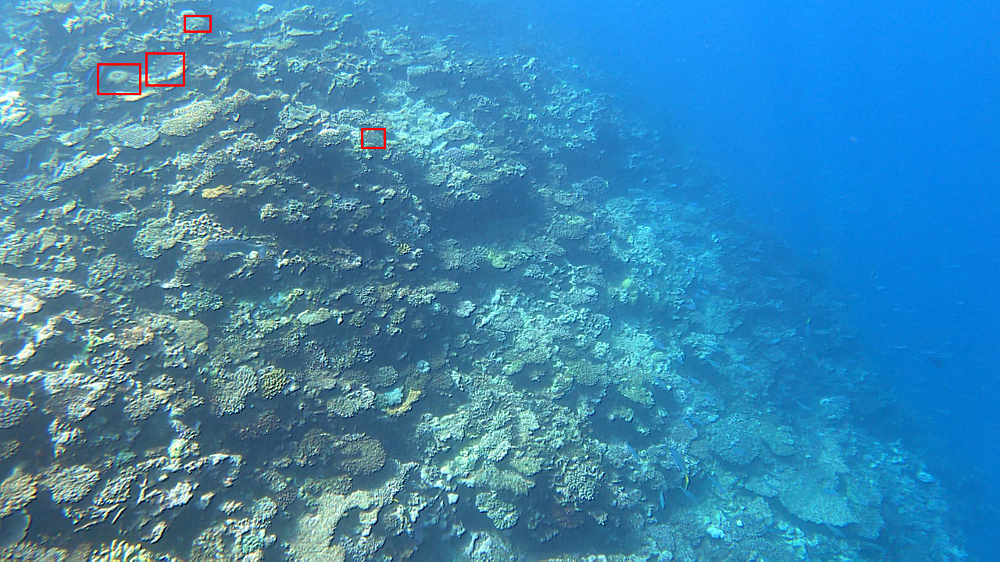

In [24]:
AUGMENTATION = A.Emboss(p = 1.0)

def aug_emboss(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
 aug_emboss(np_img)

## Color Augmentations

### HueSaturationValue

Modifie de manière aléatoire la teinte, la saturation et la valeur de l'image d'entrée.

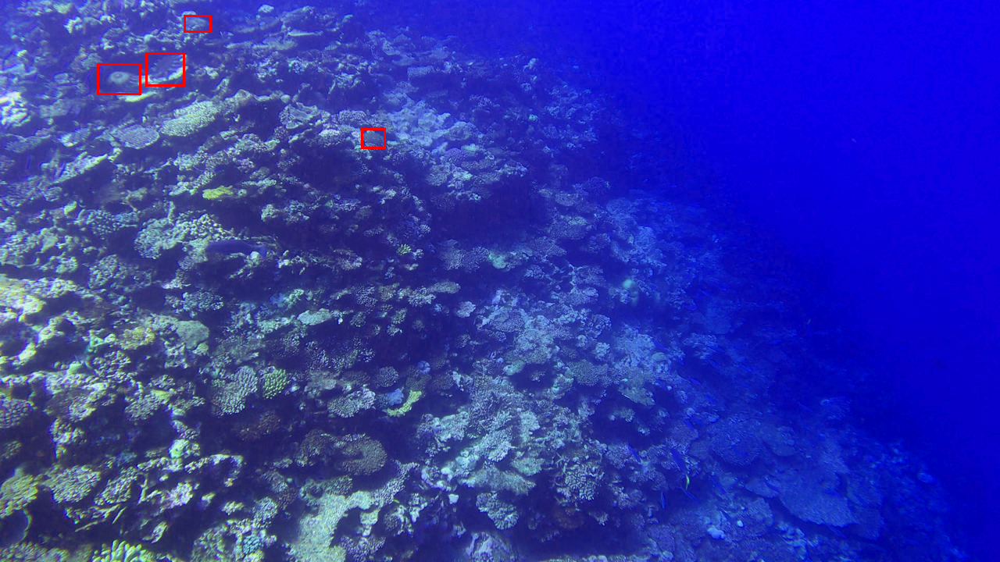

In [25]:
AUGMENTATION = A.HueSaturationValue(p = 2.0)

def aug_huesaturationvalue(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_huesaturationvalue(np_img)


### RGBShift

Décale aléatoirement les valeurs de chaque canal de l'image RGB d'entrée.

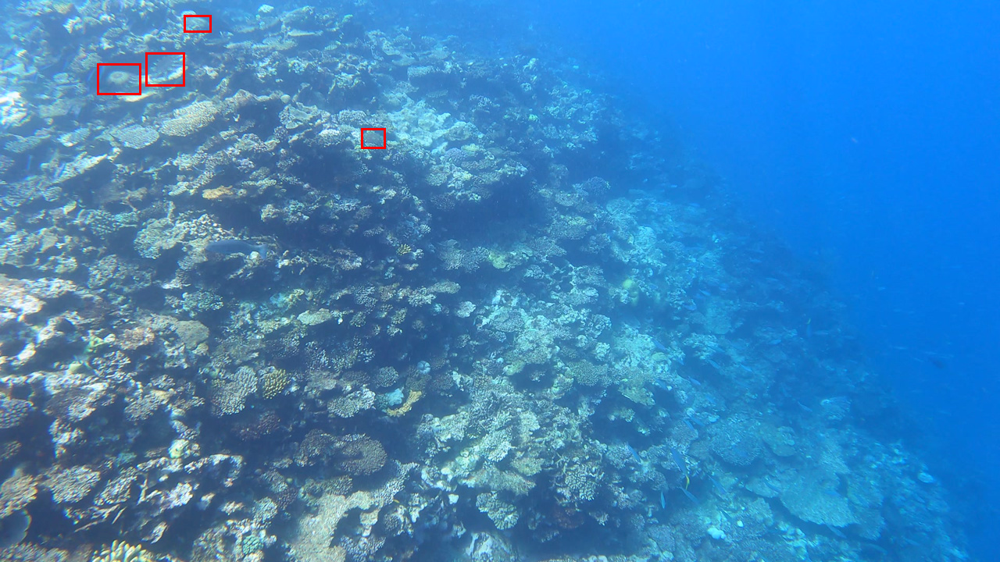

In [26]:
AUGMENTATION = A.RGBShift(p = 1.0)

def aug_rgbshift(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_rgbshift(np_img)

### RandomGamma

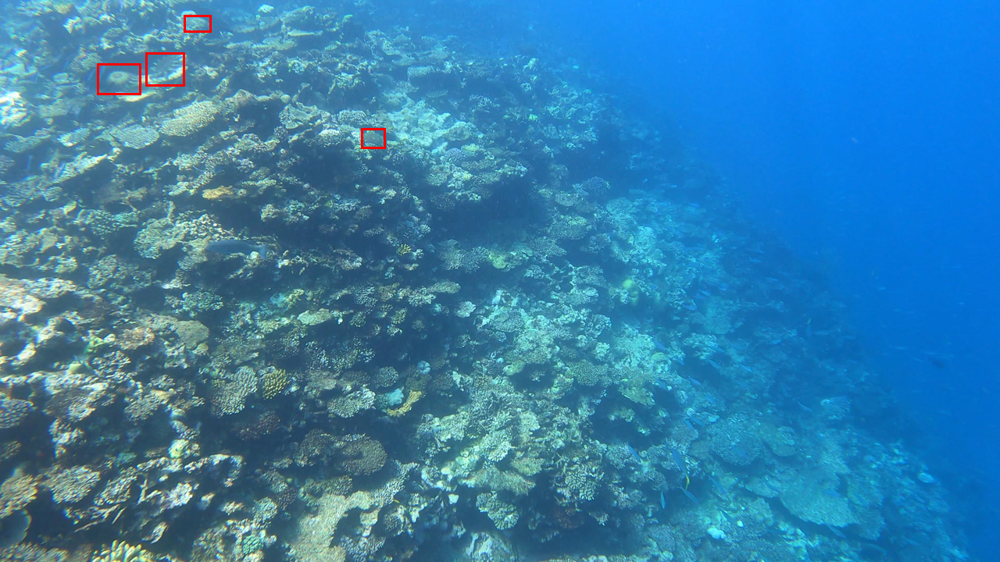

In [27]:
AUGMENTATION = A.RandomGamma(p = 1.0)

def aug_randomgamma(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_randomgamma(np_img)

## ElasticTransform

Il s'agit de l'une des transformations non rigides fournies dans Albumentation

Parmi les autres, citons GridDistortion, OpticalDistortion.

Dans les problèmes d'imagerie médicale en particulier, les transformations non rigides permettent d'augmenter les données. 

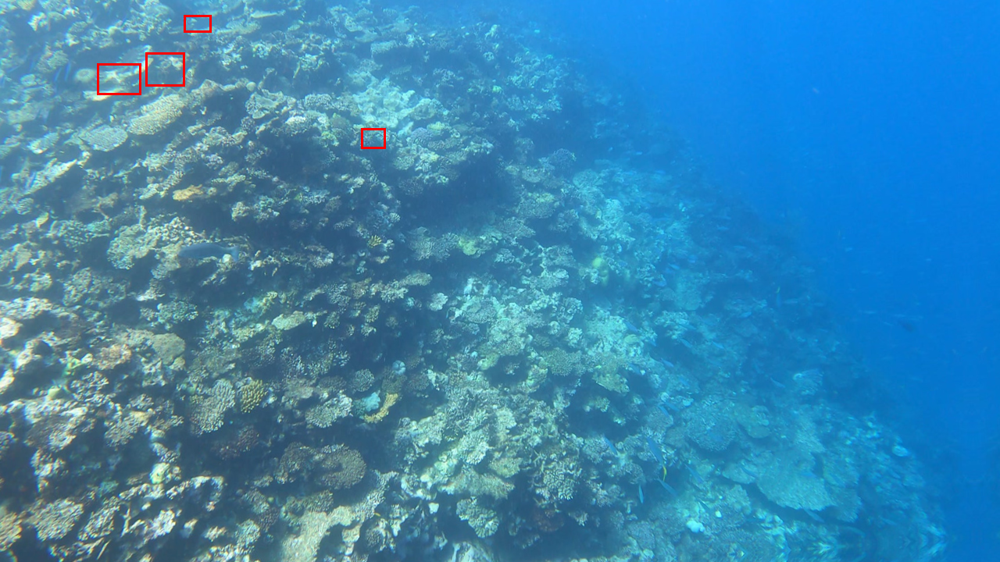

In [28]:
AUGMENTATION = A.ElasticTransform(p=1,border_mode=cv2.BORDER_REFLECT_101,alpha_affine=40)

def aug_randomgamma(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_randomgamma(np_img)

## RandomBrightnessContrast

Modifie de manière aléatoire la luminosité et le contraste de l'image d'entrée.

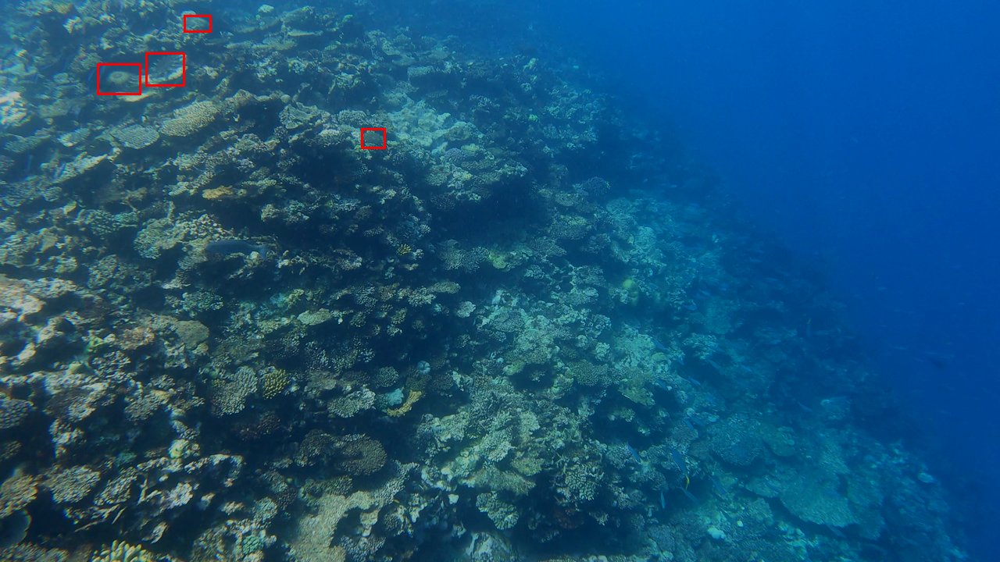

In [29]:
AUGMENTATION = A.RandomBrightnessContrast(p = 1.0)

def aug_randombrightnesscontrast(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_randombrightnesscontrast(np_img)

### ChannelShuffle

Réorganise de manière aléatoire les canaux de l'image RGB d'entrée.

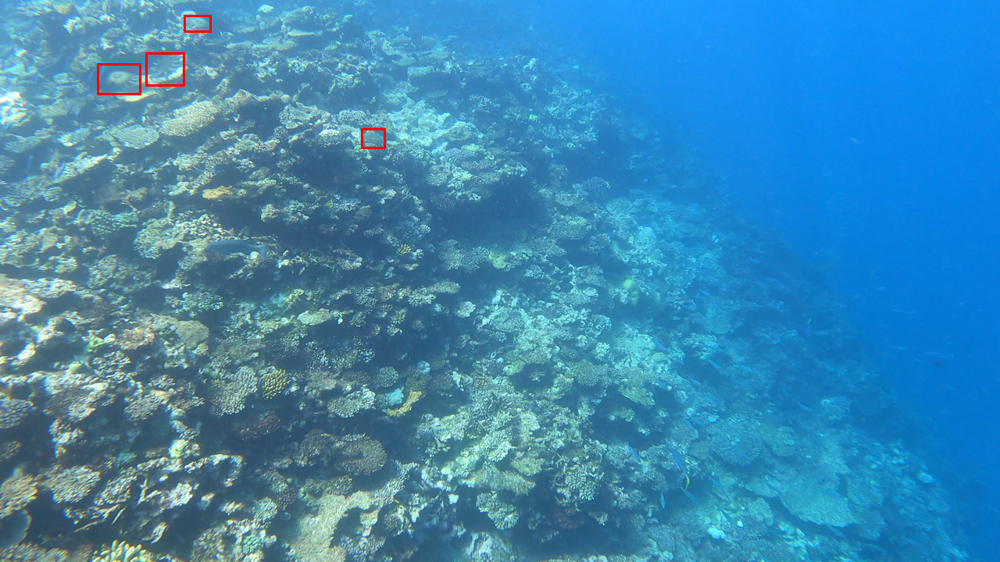

In [30]:
AUGMENTATION = A.ChannelShuffle(p = 1.0)

def aug_channelshuffle(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_channelshuffle(np_img)

### Composition augmentations:

In [31]:
from albumentations import (
    Sharpen, Emboss, ShiftScaleRotate, CLAHE, Blur, OpticalDistortion, GridDistortion, HueSaturationValue,
    GlassBlur, GaussNoise, MotionBlur, MedianBlur,
    RandomBrightnessContrast, Flip, OneOf, Compose
)

def strong_aug(p=1):
    return Compose([        
        OneOf([
            MotionBlur(p=.2),
            MedianBlur(blur_limit=3, p=.1),
            Blur(blur_limit=3, p=.1),
            GaussNoise(p=0.5),
            GlassBlur(p=0.5)
        ], p=0.2),
        ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=45, p=.2),
        OneOf([
            OpticalDistortion(p=0.3),
            GridDistortion(p=.1),
            HueSaturationValue(p=0.3)
        ], p=0.2),
        OneOf([
            CLAHE(clip_limit=2),
            Sharpen(),
            Emboss(),
            RandomBrightnessContrast(),  # Remplacement de RandomContrast et RandomBrightness
        ], p=0.3),
        # HueSaturationValue(p=0.3),
    ], p=p)

# Exemple d'utilisation
aug = strong_aug(p=1)


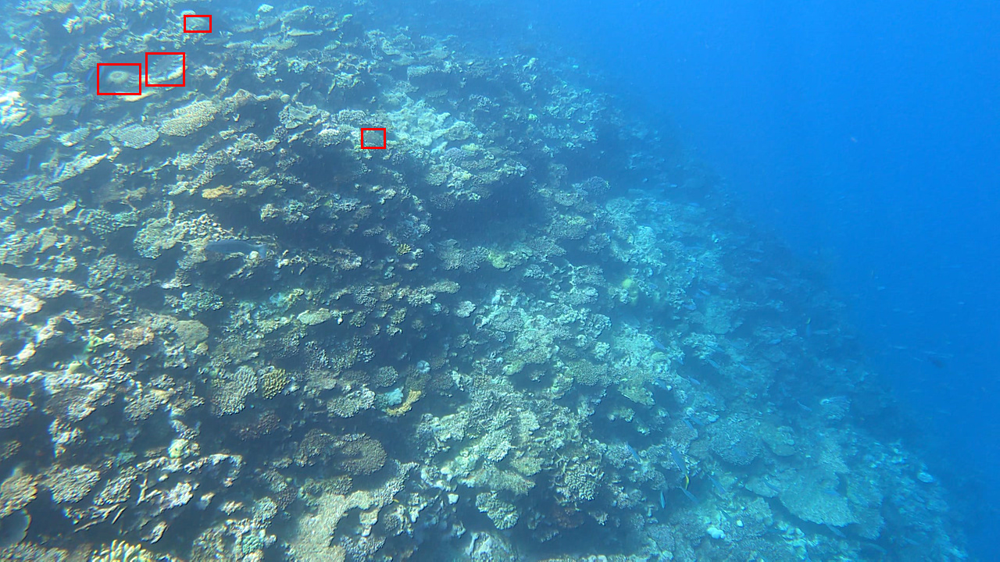

In [32]:

AUGMENTATION = strong_aug(p=1)

def aug_composite(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_composite(np_img)